# PW 1 - Markovian models  
Sampling of Markovian models.

The aim of this session is to program the Gibbs sampler algorithm and study it in the binary case.

In this section we consider a binary Markov random field (taking values in $E=\{0,1\}$).
The neighborhood is defined in 4-connexity and the potential of a clique of order 2 is defined by :
$U_c(0,1)=U_c(1,0)=+\beta$ and $U_c(1,1)=U_c(0,0)=0$ (the potential for singleton clique is 0).


In [1]:
import math
import random
import numpy as np
import platform
import tempfile
import os
import matplotlib.pyplot as plt
import imageio
from scipy import ndimage as ndi

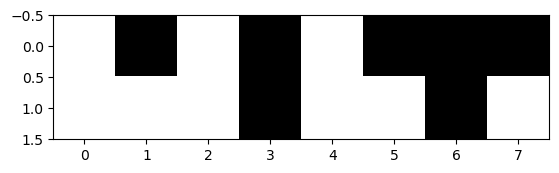

In [2]:
plt.set_cmap('gray')

sh=[2,8]
np.random.seed(5)
imaU=2-np.ceil(2*np.random.rand(*sh))
plt.imshow(imaU)

#Q1
For the Ising model defined above, and the imaU generated in the previous cell, give the formula of the global energy and give its value as a function of $\beta$ for imaU.

#A1
$U(x) = \sum_{c\in C}V_c(x) = \beta \sum_{c = (s,t)}\mathbb{1}_{\{x_s \neq x_t\}}$

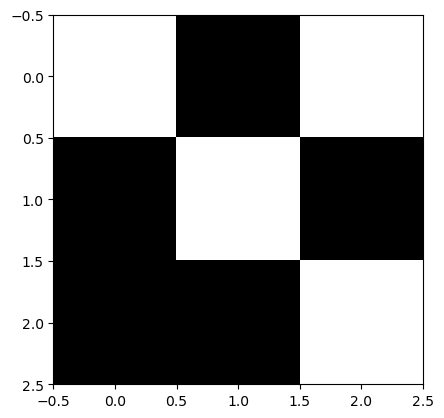

In [3]:
sh=[3,3]
np.random.seed(5)
imaVois=2-np.ceil(2*np.random.rand(*sh))
plt.imshow(imaVois)

#Q2

Write the general form of the local conditional probability in a pixel $s$. For the neighborhood configuration imaVois generated by the previous code cell, compute the 2 local conditional energies (for the value 0 and for the value 1 of the central pixel), then the local conditional probabilities (as a function of $\beta$). What is the most probable class ? (NB: do the calculation for an 8-neighborhood).


#A2

$Pr(X_s | X^s = x^s) = Pr(X_s = x_s | V_s) = \frac{e^{-U(x_s|V_s)}}{\sum_{\xi \in E}e^{-U(\xi|V_s)}}$

Since $V_{c = (s,t)}(x_s,x_t) = \beta\mathbb{1}_{\{x_s \neq x_t\}} $,

$$
U(x_s = 0, V_s =(1,0,1,0,1,0,0,0)) = 3\beta \\
U(x_s = 1, V_s =(1,0,1,0,1,0,0,0)) = 5\beta
$$
so 
$$Pr(X_s = 0|V_s) = \frac{e^{-3\beta}}{e^{-3\beta}+e^{-5\beta}}\\
Pr(X_s = 1|V_s) = \frac{e^{-5\beta}}{e^{-3\beta}+e^{-5\beta}}$$

## Part 1

Programming the Gibbs sampler and drawing samples of Markovian models



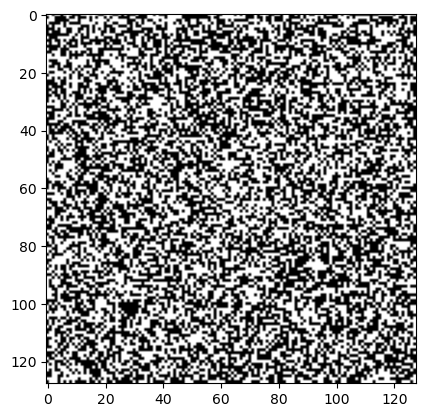

In [4]:
plt.set_cmap('gray')

sh=[128,128]

im_bin=2-np.ceil(2*np.random.rand(*sh))
plt.imshow(im_bin)

### Sampling function
Complete the following function which takes as input a binary image (which will be updated by Gibbs sampling) and the value of the regularization parameter.


In [5]:
def echan(im_bin,beta_reg):

    i=0;
    j=0;

    for i in range(im_bin.shape[0]):
        for j in range(im_bin.shape[1]):
          # do not change these indices
          # they allow access to neighboring pixels
          # i1,j and i2,j and i,j1 and i,j2
            i1=(i-1)%im_bin.shape[0]
            i2=(i+1)%im_bin.shape[0]
            j1=(j-1)%im_bin.shape[1]
            j2=(j+1)%im_bin.shape[1]

        # complete the calculation of energies and associated probabilities
        # energy and non-normalized proba when the pixel is put in class 0
            Ureg0 =  beta_reg *(im_bin[i1,j] + im_bin[i2,j] + im_bin[i,j1] + im_bin[i,j2])
            p0 = math.exp(-Ureg0);

        # energy and non-normalized proba when the pixel is put in class 1
            Ureg1 = 4 * beta_reg - Ureg0
            p1=math.exp(-Ureg1);

        # sampling according to the normalized probabilities. NB: the normalization is done here
            if (p0+p1!=0.):
                if(random.uniform(0,1)<p0/(p0+p1)):
                    im_bin[i,j] = 0
                else :
                    im_bin[i,j] = 1

    return im_bin


By varying the value of the regularization parameter and restarting the cell, observe. You can remove the visualization during sampling and increase the number of iterations

In [6]:
def random_bin(beta_reg = 1 , echan = echan):
    # random initialization of im_bin
    plt.set_cmap('gray')
    sh=[128,128]
    im_bin=2-np.ceil(2*np.random.rand(*sh))
    plt.imshow(im_bin)

    mafigure=plt.figure()
    plt.imshow(im_bin);
    mafigure.canvas.draw()
    plt.show()

    for n in range(10):
        echan(im_bin,beta_reg)
        plt.imshow(im_bin)
        mafigure.canvas.draw()
        plt.show(block=False)


    plt.figure()
    plt.imshow(im_bin)
    plt.show()

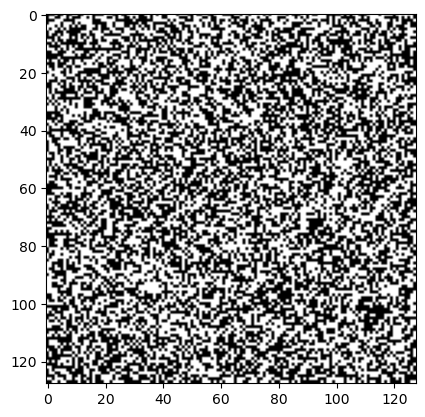

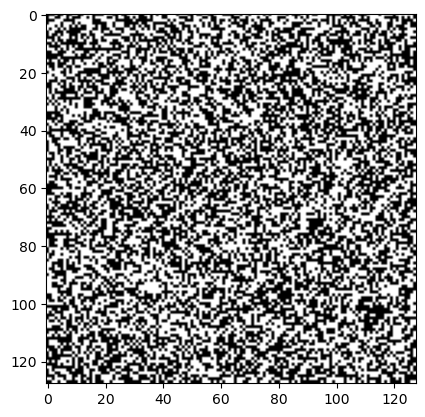

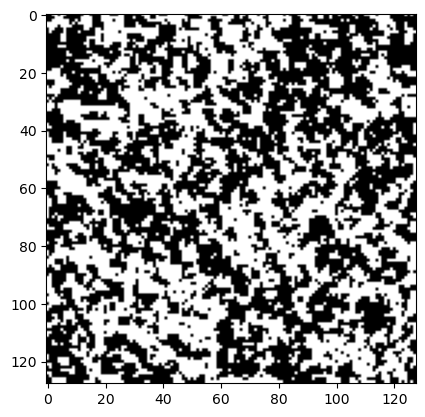

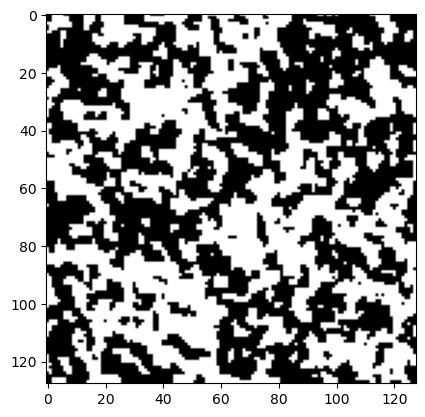

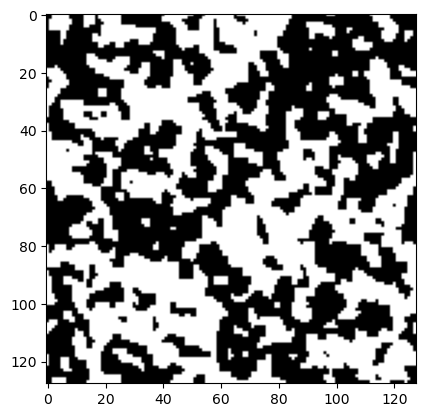

...

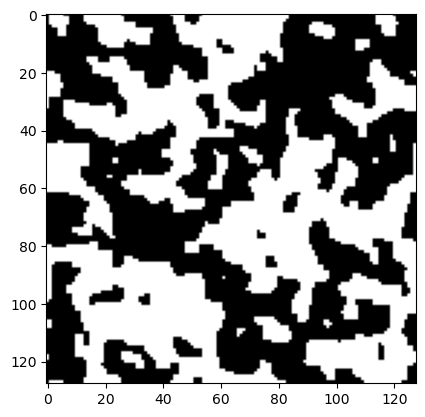

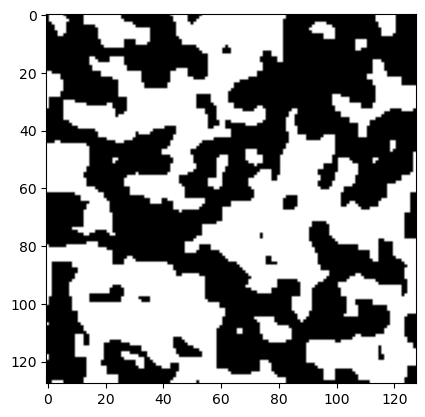

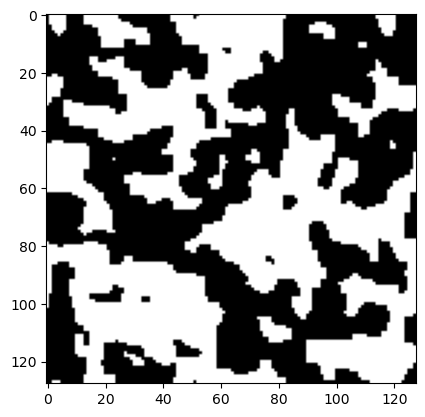

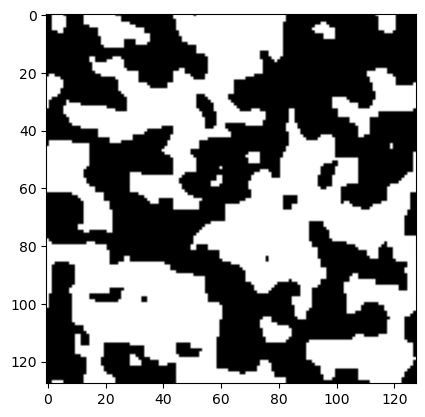

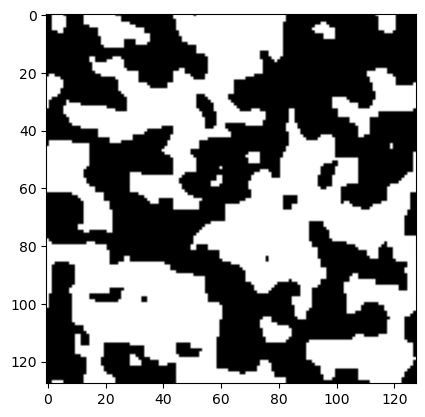

In [7]:
random_bin(beta_reg = 5)

#Q3
Run the program several times. Do you still get the same image? Comment on this.

#A3 : No, the program will not consistently generate the same image with each execution. The non-uniformity arises from the random initialization of im_bin and the stochastic nature inherent in the Gibbs sampling method. The state of each pixel is contingent on both its neighbors and the randomness introduced during sampling, leading to diverse outcomes in each iteration.

#Q4 Vary $\beta$ from 0.5 to 20. Comment on the results.

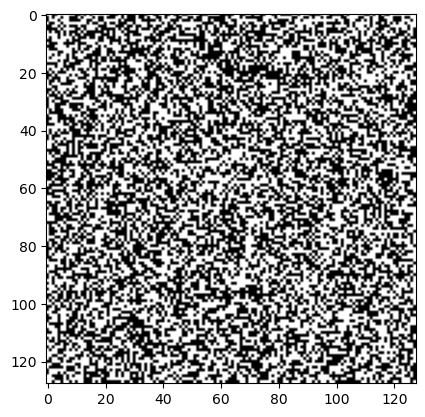

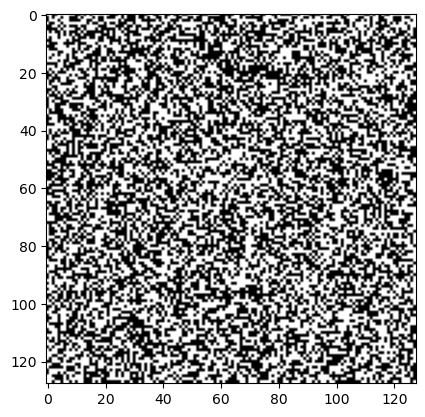

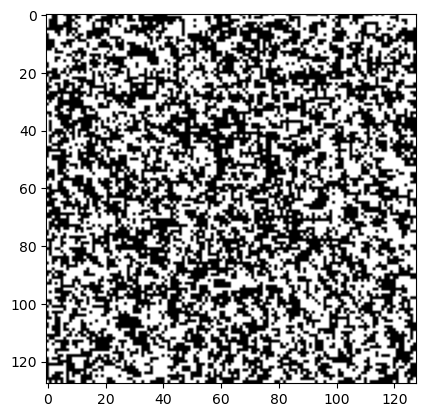

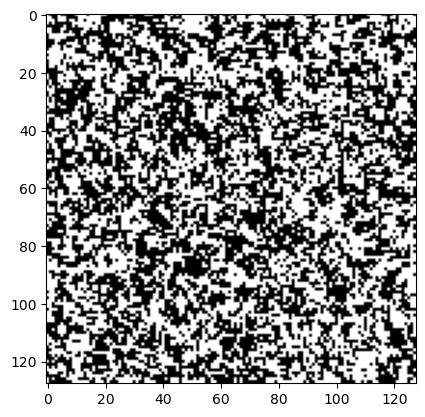

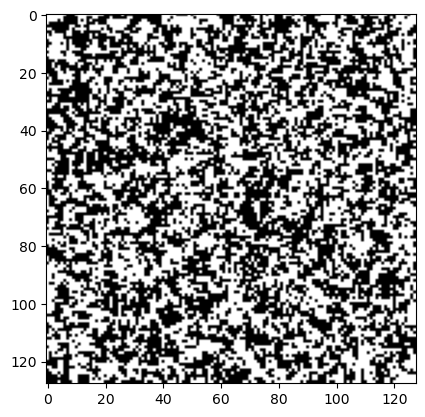

...

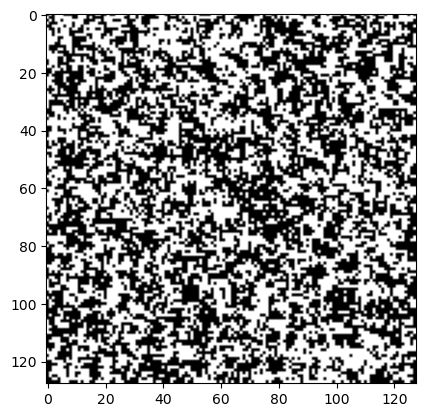

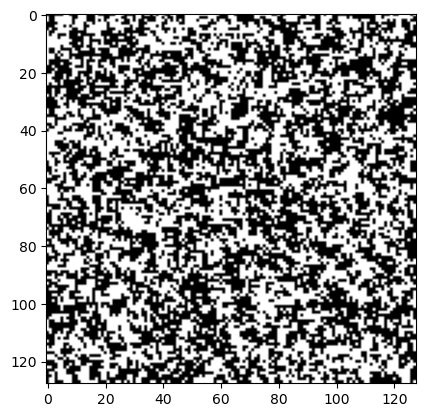

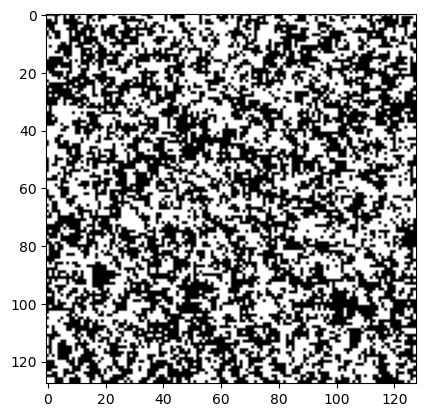

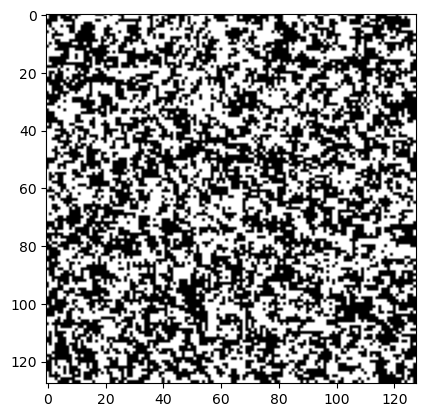

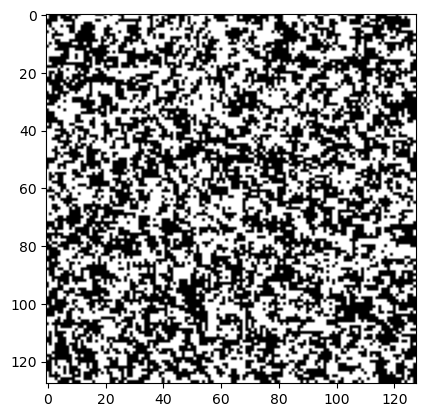

In [8]:
random_bin(beta_reg = 0.5)

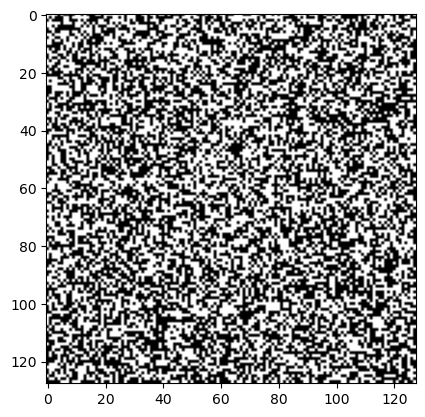

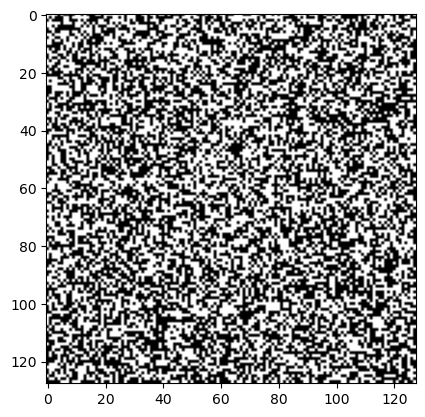

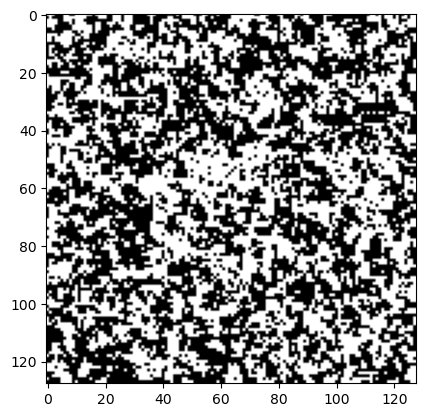

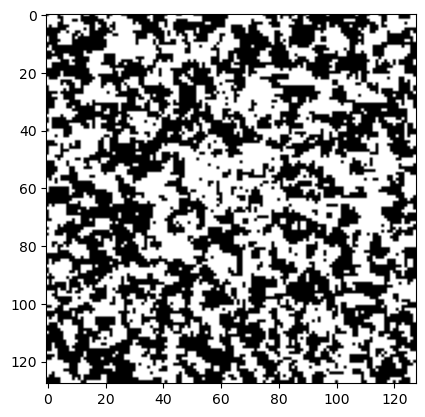

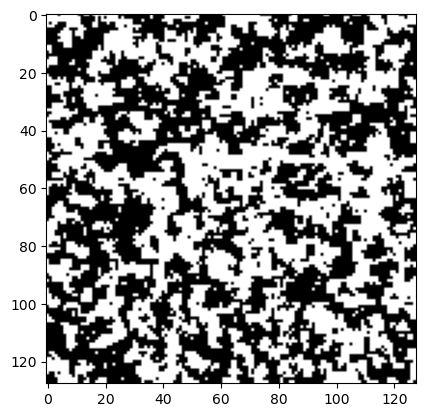

...

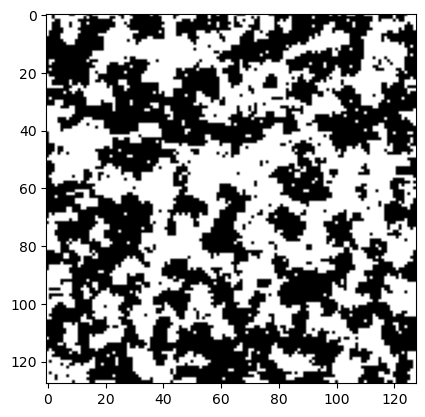

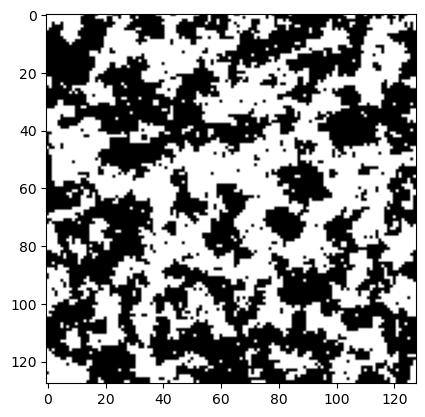

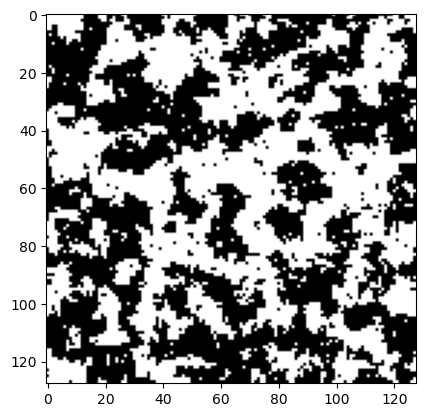

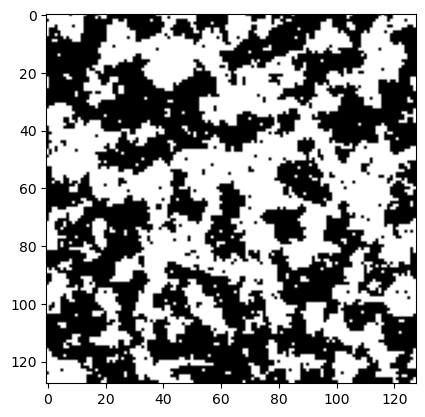

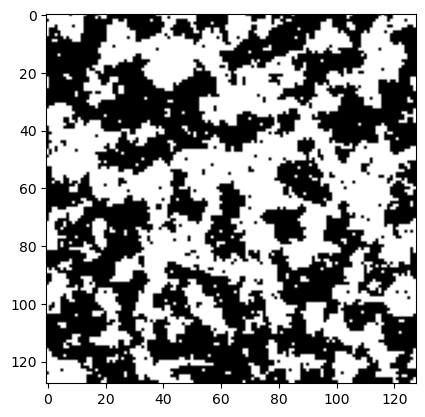

In [9]:
random_bin(beta_reg = 1)

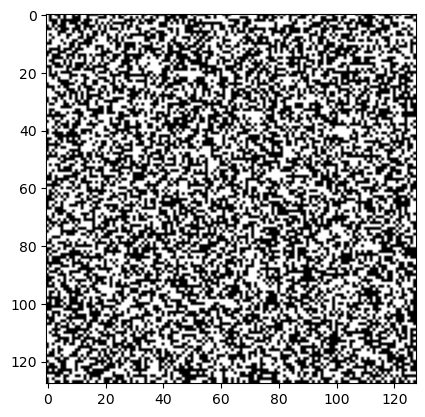

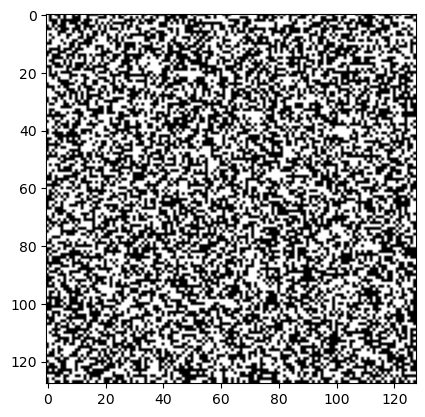

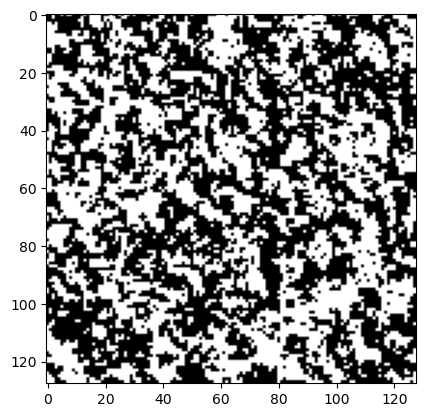

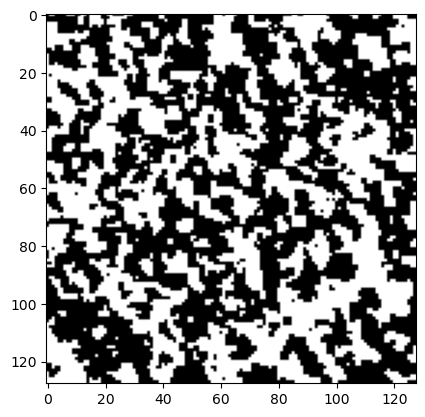

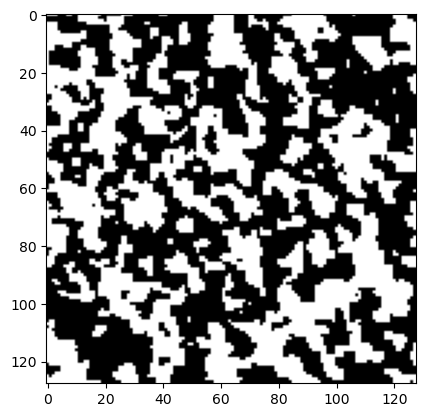

...

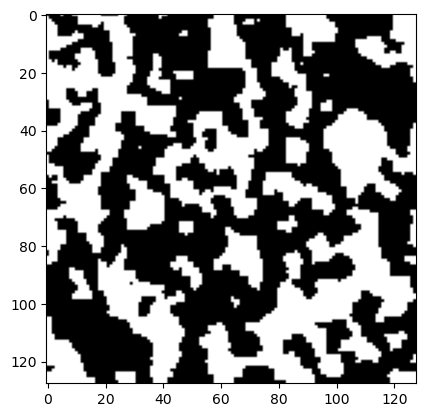

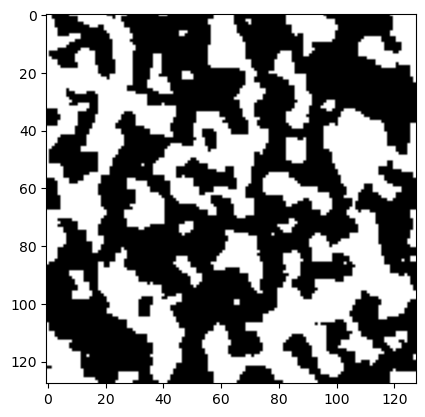

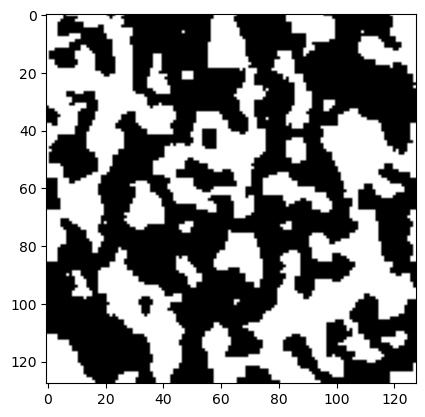

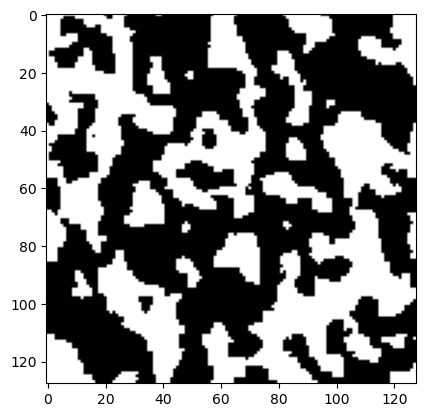

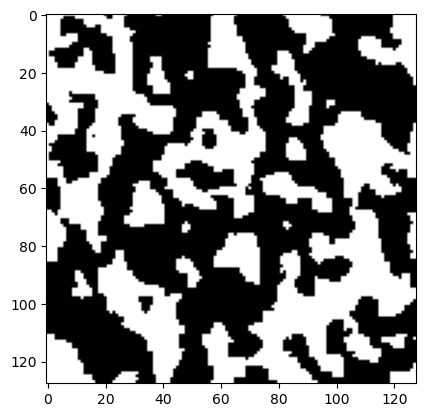

In [10]:
random_bin(beta_reg = 2)

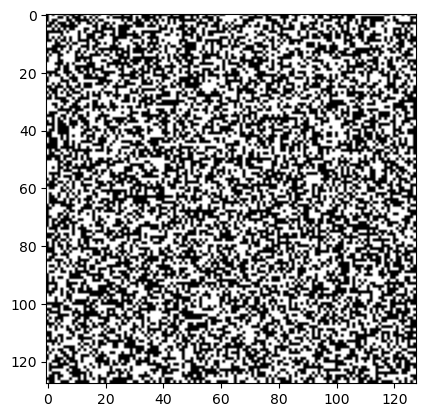

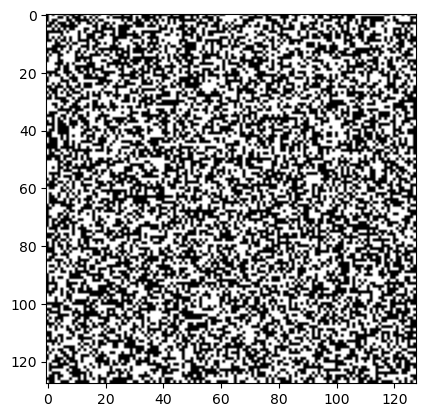

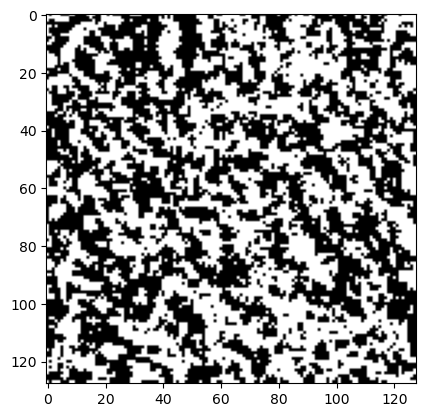

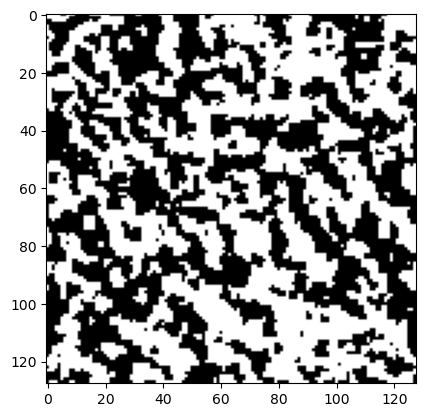

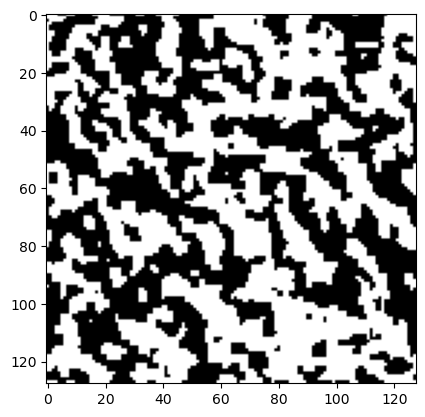

...

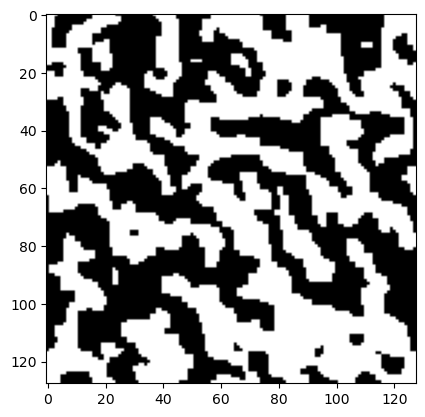

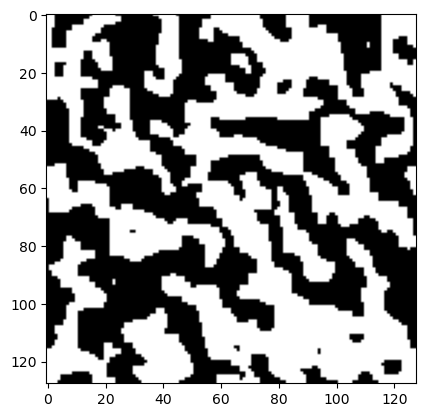

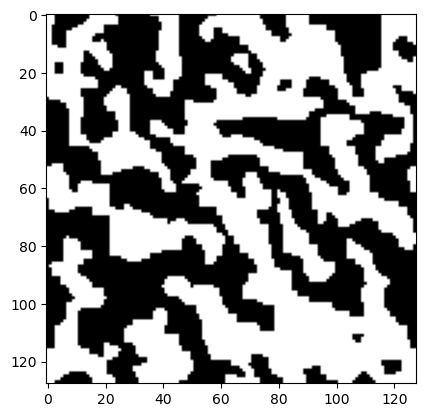

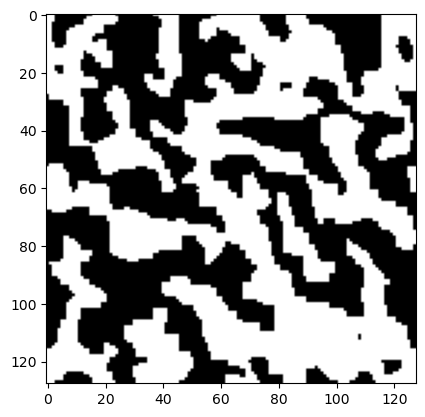

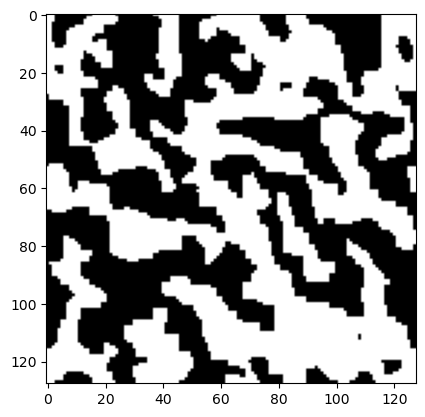

In [11]:
random_bin(beta_reg = 5)

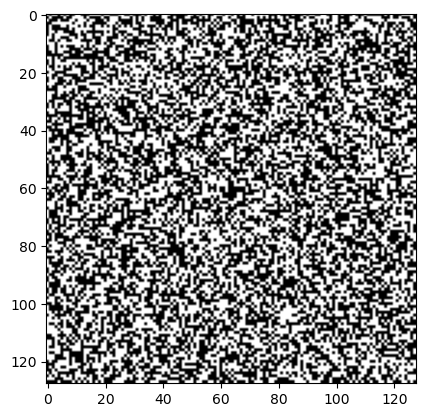

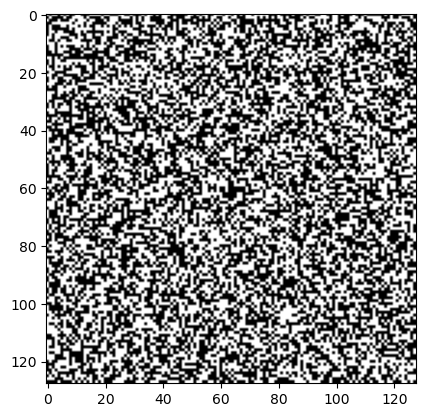

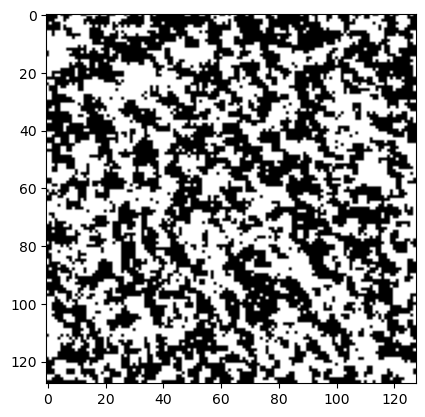

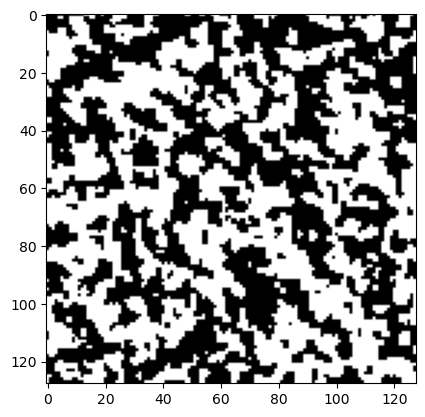

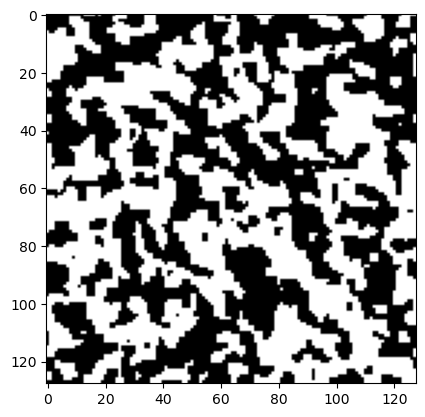

...

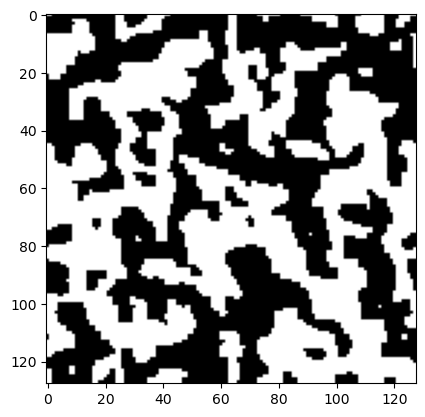

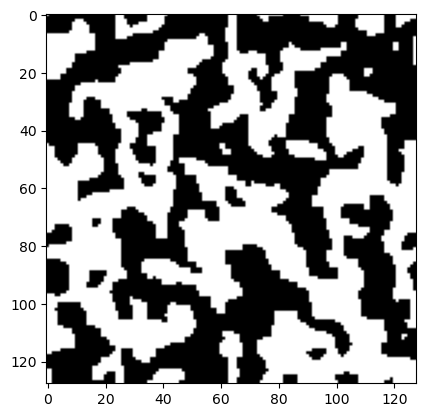

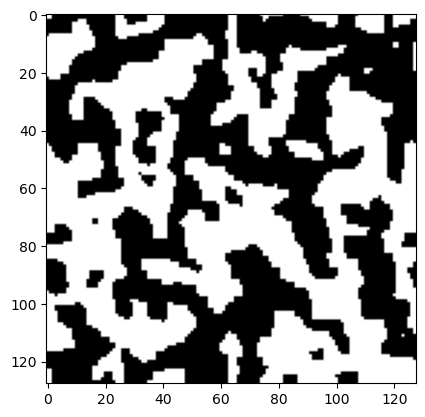

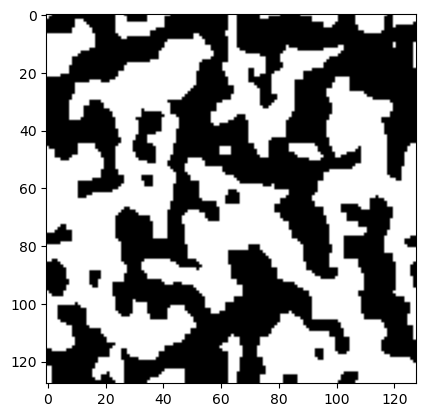

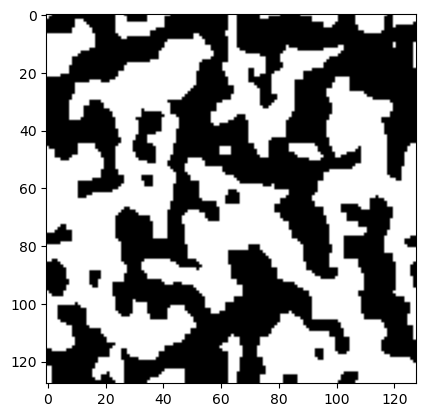

In [12]:
random_bin(beta_reg = 10)

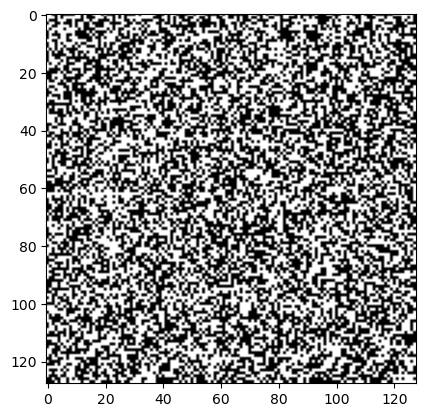

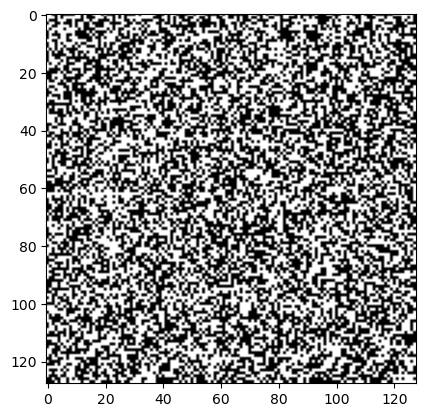

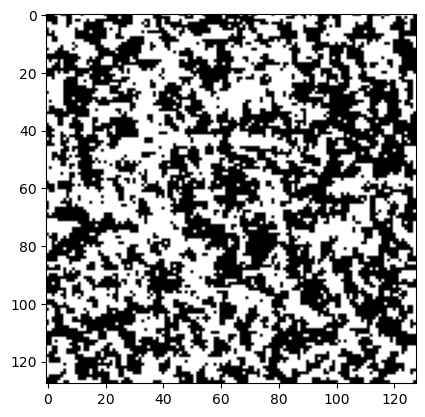

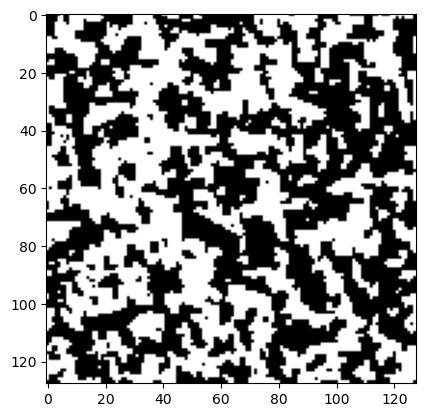

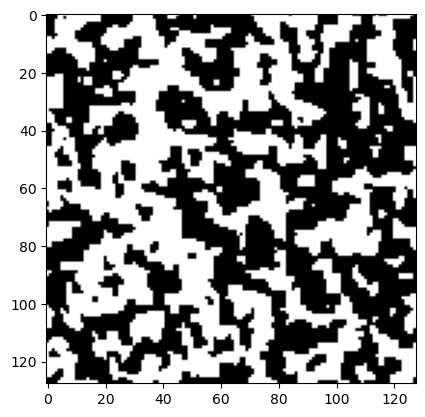

...

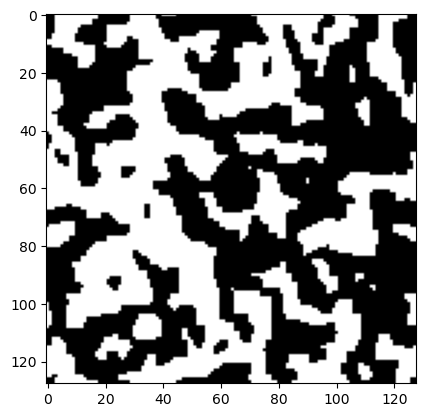

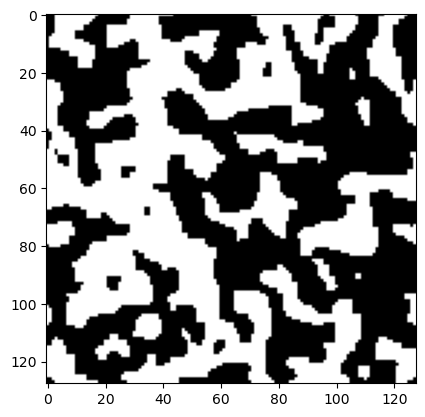

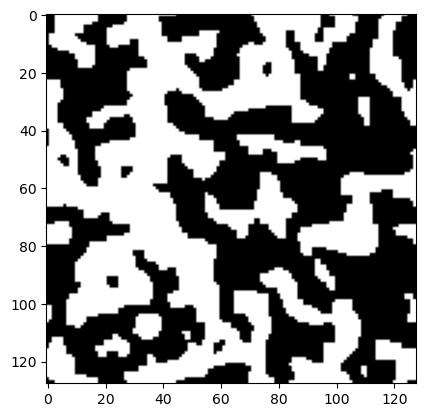

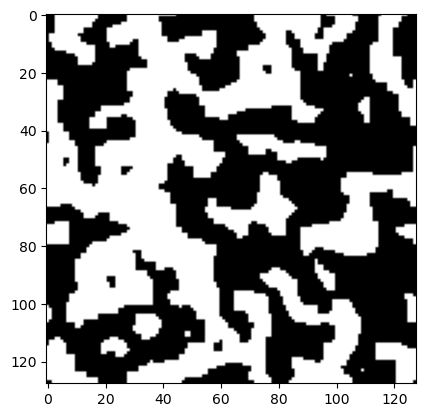

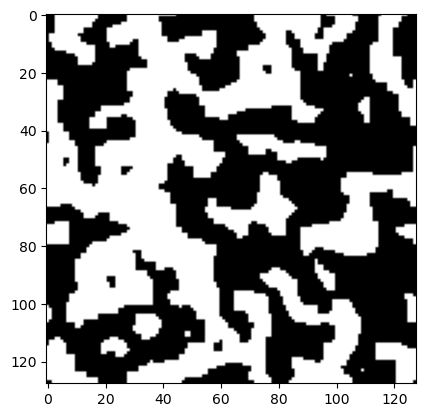

In [13]:
random_bin(beta_reg = 20)

#A4 : Modulating the regularization parameter, β, influences the image transformation behavior. Lower β values reduce regularization, causing pixel values to be more influenced by randomness than neighboring pixels. This may result in a "noisier" or less coherent image. Conversely, higher β values enhance the impact of neighboring pixels, fostering uniform regions and reducing noise. Increasing β may lead to a more segmented image with larger uniform regions.

#Q5
Which image minimizes the overall energy for this model?

#A5: The image that minimizes the overall energy for this model is the one where the pixel values are most aligned with their neighboring pixels, according to the energy function defined by the regularization parameter $\beta$: $U(x) = \sum_{c\in C}V_c(x) = \beta \sum_{c = (s,t)}\mathbb{1}_{\{x_s \neq x_t\}}$. In the context of this model, it would be an image where large regions of pixels are either 0 or 1, with minimal border areas where the pixel values change, as borders increase the energy, which indicates higher values of $\beta$. In our case, $\beta = 20$.


#Q6
Change 𝛽 and give it a negative value. Describe the result and justify it.

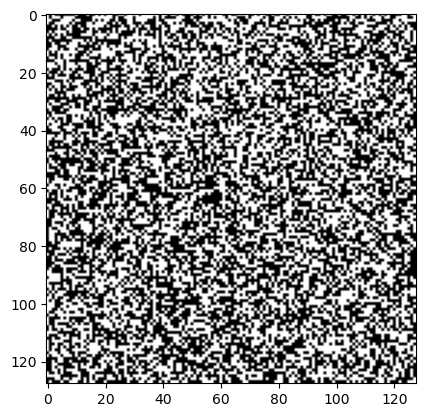

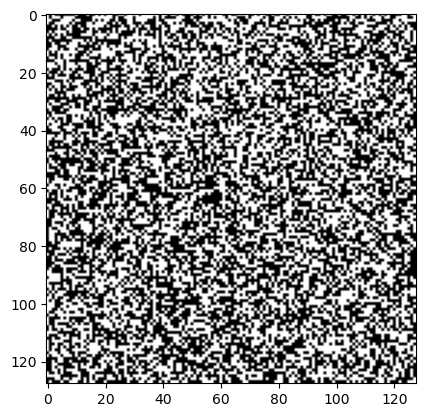

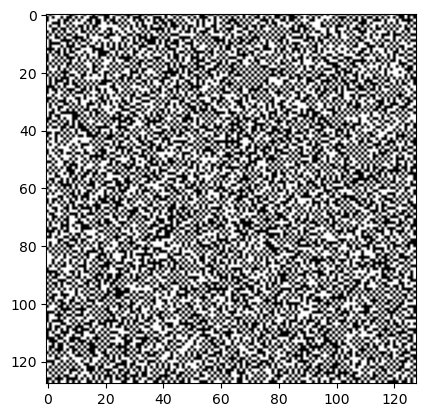

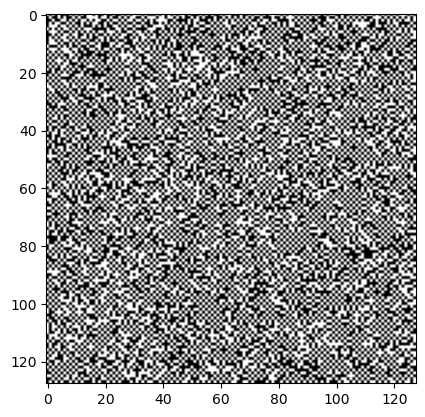

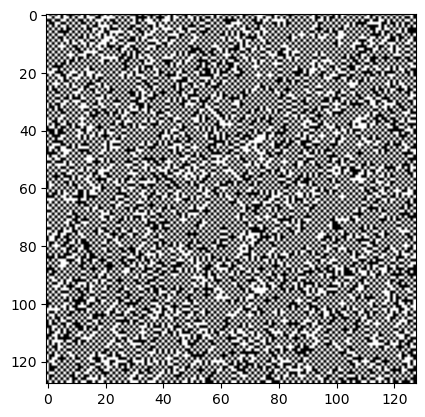

...

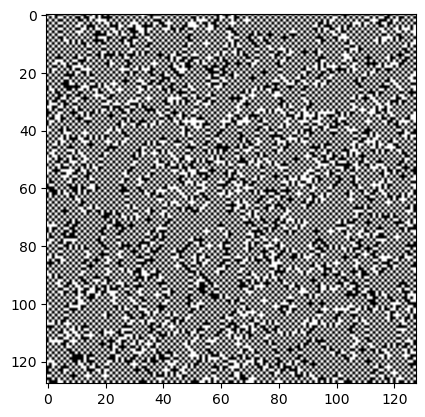

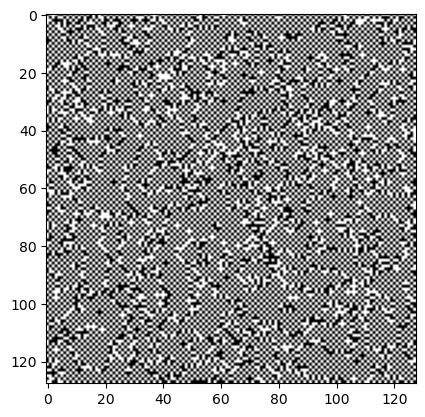

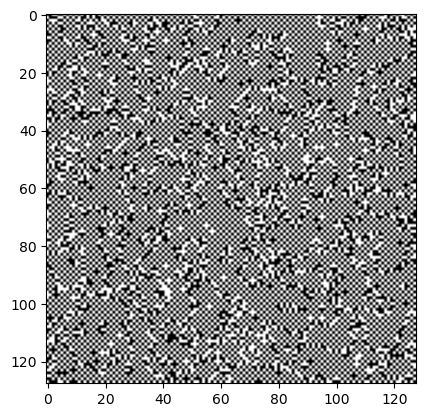

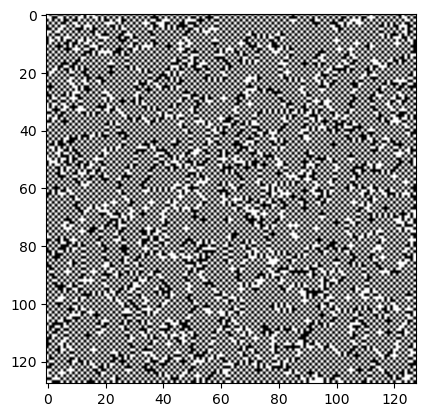

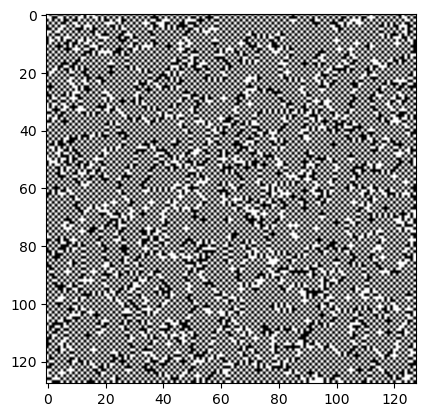

In [14]:
random_bin(beta_reg = -1)

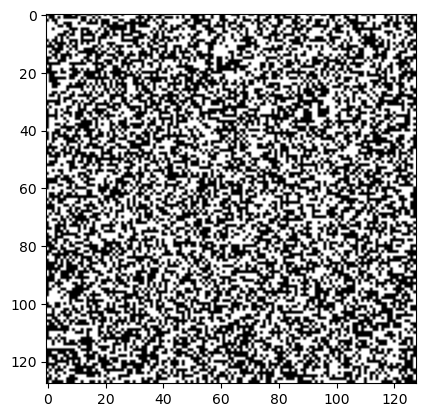

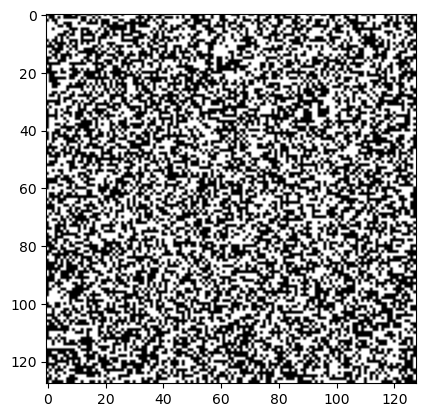

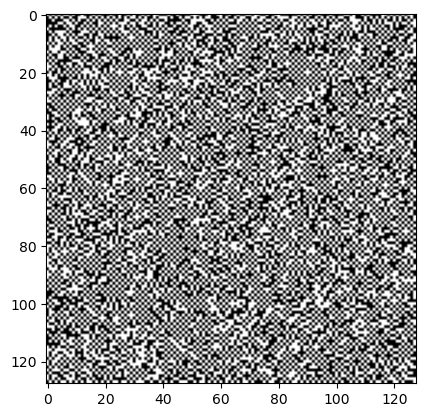

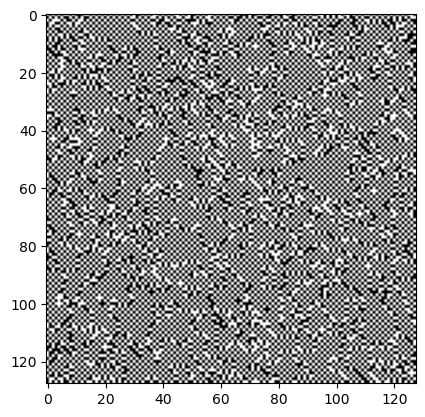

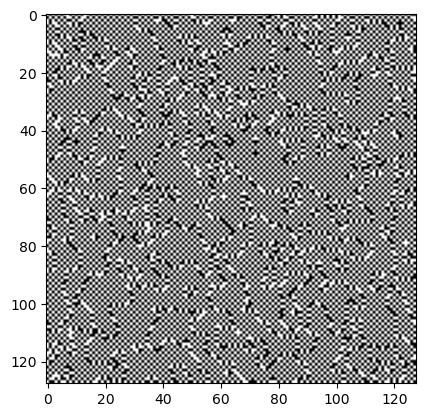

...

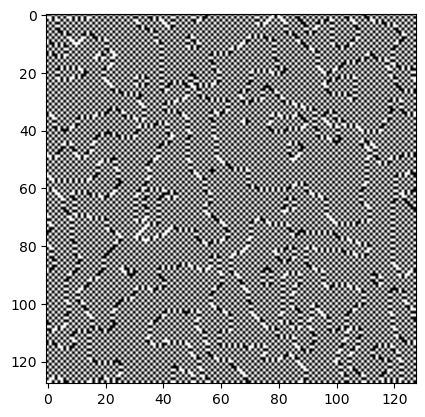

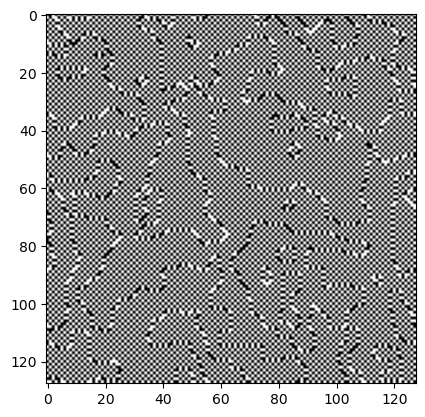

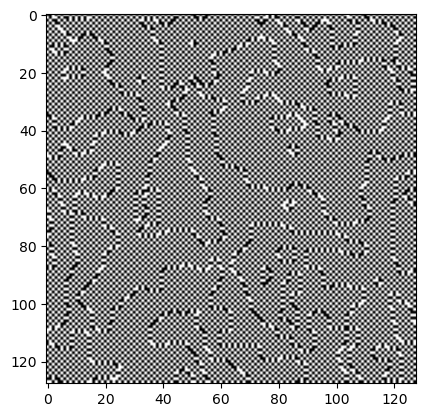

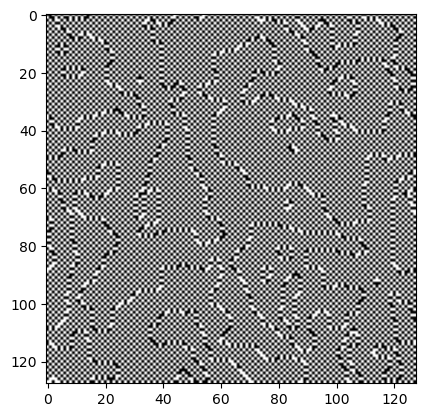

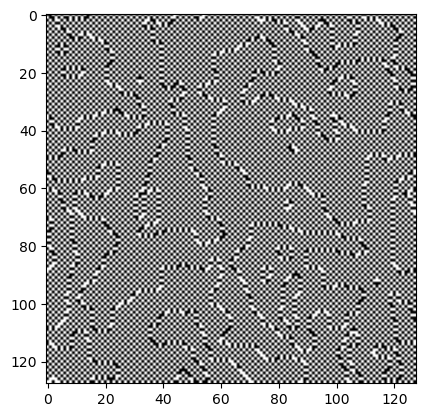

In [15]:
random_bin(beta_reg = -10)

#A6 : Giving β a negative value would invert the preference for pixel alignment. Instead of favoring similar neighboring pixel values, the model would favor dissimilarity. This would likely result in a more "checkerboard" pattern, where neighboring pixels tend to have opposite values, as this configuration would minimize energy in a model with negative β.

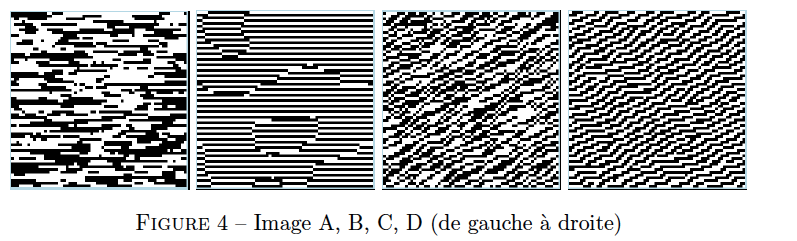

#Q7
We now work in 8-neighborhood, but still with cliques of order 2 (non-isotropic this time). For each of the following images, propose the clique potentials that allow us to obtain these realizations. Initially all clique potentials are zero.


* Image A : there is only one clique potential of order 2 which is -1.
* Image B : in addition to the previous one, there is a clique potential of order 2 which is 1. Indicate which one.
* Image C: in addition to the 2 previous ones, there is a clique potential of order 2 which is -1. Indicate which one.
* Image D: in addition to the 3 previous ones, there is a second order clique potential which is +1. Indicate which one.





#A7 : 
- Image A: The observed pattern implies a tendency for pixels to share the same value as their immediate horizontal and vertical neighbors. The clique potential of order 2, set at -1, likely reinforces this similarity among adjacent pixels in both horizontal and vertical directions.

- Image B: This image displays discernible horizontal stripes, indicating similarity among horizontal neighbors, while no such regularity is present vertically. Considering that Image A already promotes horizontal and vertical similarity through a -1 potential, in Image B, it becomes necessary to introduce a positive clique potential to encourage dissimilarity in the vertical direction. Thus, an added clique potential of order 2, set at +1, should be applied to the vertical neighbors.

- Image C: Featuring a distinct diagonal striping pattern, Image C prompts a shift in strategy. Since Image B has already established vertical dissimilarity, the focus now shifts to encouraging diagonal similarity. Consequently, introducing a negative potential for diagonal neighbors is essential. Therefore, the supplementary clique potential of order 2, set at -1, should be applied to the diagonal neighbors in Image C.

- Image D: The pattern in this image is more intricate, displaying both horizontal and diagonal striping. Considering the encouragement of horizontal similarity, vertical dissimilarity, and diagonal similarity in the preceding images, Image D requires an additional second-order clique potential of +1. This potential aims to promote diagonal dissimilarity, counteracting the diagonal similarity introduced in Image C.

#Q8 Modify your program to define an Ising model with a diagonal attractive potential only (the other potentials are zero). It means that this model **encourages** similar labels (either 0 or 1) for neighboring pixels in the diagonal directions ($\pi/4$ or $3\pi/4$ directions). Comment on the result.

In [16]:
def echan_diag(im_bin,beta_reg):

    i=0;
    j=0;

    for i in range(im_bin.shape[0]):
        for j in range(im_bin.shape[1]):
          # do not change these indices
          # they allow access to neighboring pixels
          # i1,j and i2,j and i,j1 and i,j2
            i1=(i-1)%im_bin.shape[0]
            i2=(i+1)%im_bin.shape[0]
            j1=(j-1)%im_bin.shape[1]
            j2=(j+1)%im_bin.shape[1]

        # complete the calculation of energies and associated probabilities
        # energy and non-normalized proba when the pixel is put in class 0
            Ureg0 =  beta_reg *(im_bin[i1,j1] + im_bin[i2,j1] + im_bin[i1,j2] + im_bin[i2,j2])
            p0 = math.exp(-Ureg0);

        # energy and non-normalized proba when the pixel is put in class 1
            Ureg1 = 4 * beta_reg - Ureg0
            p1=math.exp(-Ureg1);

        # sampling according to the normalized probabilities. NB: the normalization is done here
            if (p0+p1!=0.):
                if(random.uniform(0,1)<p0/(p0+p1)):
                    im_bin[i,j] = 0
                else :
                    im_bin[i,j] = 1

    return im_bin

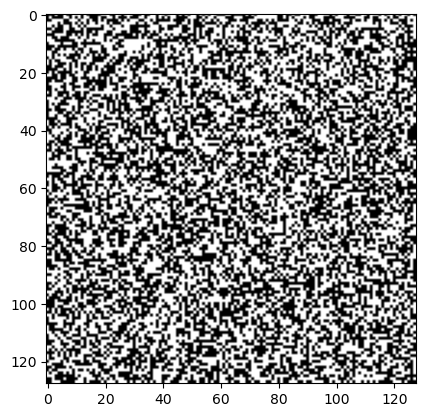

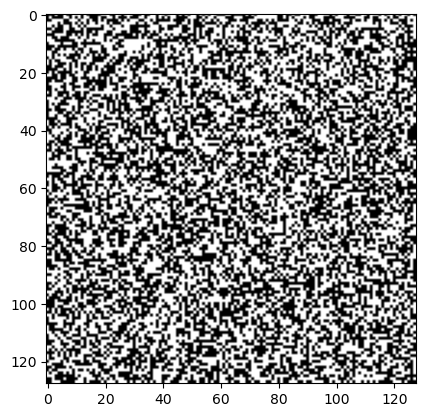

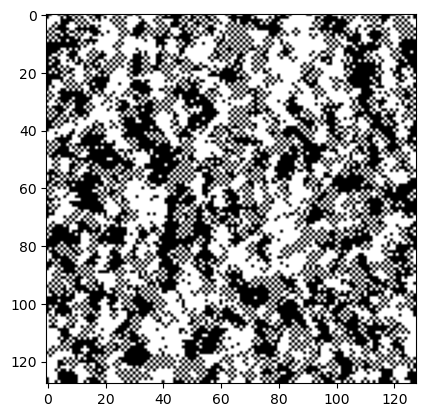

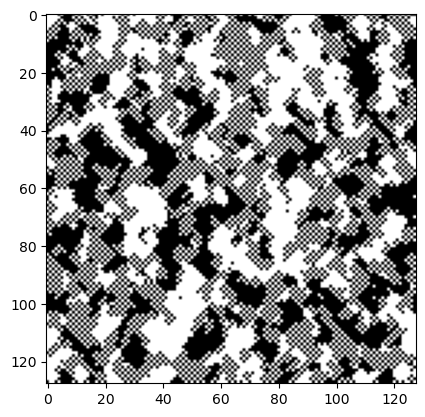

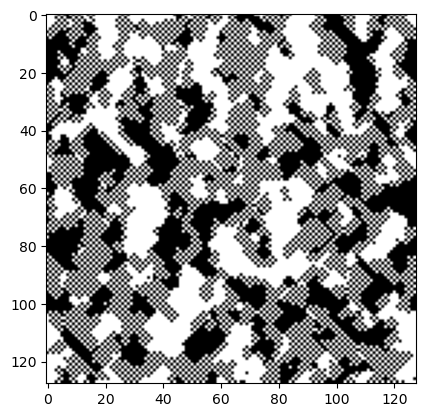

...

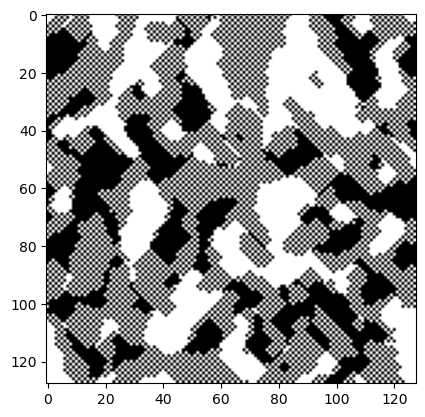

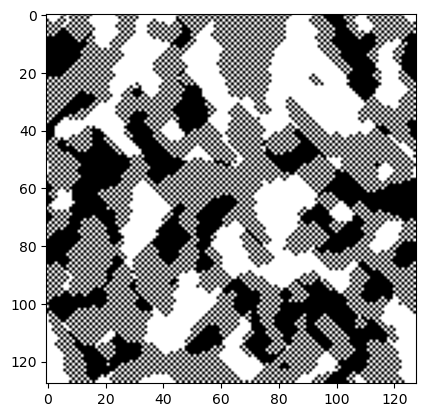

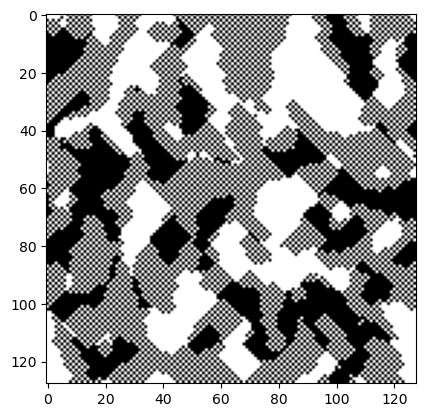

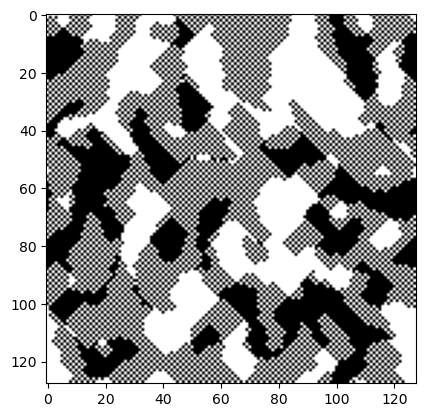

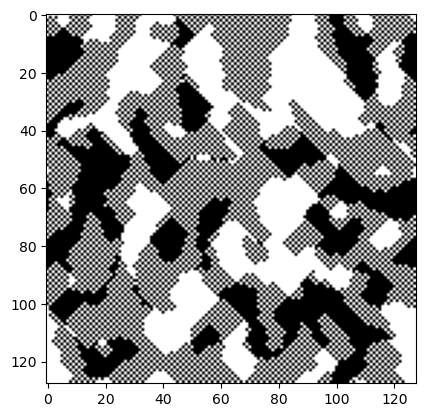

In [17]:
random_bin(beta_reg = 10, echan = echan_diag)

#A8 : Executing this modified program will reveal a more pronounced alignment of pixel patterns along the diagonal axes. The resultant images will exhibit a distinct appearance in contrast to those generated by a conventional Ising model, highlighting the impact of exclusively taking into account diagonal interactions. This illustrates the substantial effect that modifying interaction rules in a model can have on the system's behavior and ultimate outcome.